# Simulations
How To simulate
in this notebook we want to give an example how the Ensembler package can be used to simulate systems.

In [1]:
#if package is not installed:
import os, sys
my_path = os.getcwd()+"/.."
sys.path.append(my_path)

import tempfile
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline


#Ensembler
##COde
from ensembler.potentials.OneD import harmonicOscillatorPotential
from ensembler.samplers.stochastic import monteCarloIntegrator, metropolisMonteCarloIntegrator, langevinIntegrator
from ensembler.samplers.newtonian import positionVerletIntegrator, leapFrogIntegrator
from ensembler.samplers.optimizers import conjugate_gradient
from ensembler.conditions.box_conditions import periodicBoundaryCondition

from ensembler.system import system

##Visualisation
from ensembler.visualisation.plotPotentials import plot_1DPotential
from ensembler.visualisation.plotSimulations import simulation_analysis_plot
from ensembler.visualisation.animationSimulation import animation_trajectory


## General Settings

In [2]:
sim_steps=1000

### Define a Potential
Here we define a Potetial, that we want to integrate (you can find more potential Examples in the BasicPotential jupyter notebook).

(<Figure size 243.78x150.664 with 2 Axes>, None)

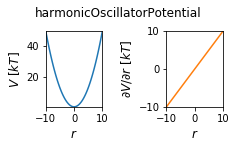

In [3]:
#settings
space_range = [-10, 10]

##Simulation Setup
pot=harmonicOscillatorPotential()

#Visualize
positions = np.linspace(-10,10, 100)
plot_1DPotential(pot, positions=positions)


## Stochastic Integrators

### MonteCarlo  Simulations

Simulation:  Simulation: 100%|██████████| 1000/1000 [00:11<00:00, 87.32it/s]


last_state:  State(position=array(0.62), temperature=298.0, total_system_energy=0.19219999999999499, total_potential_energy=0.19219999999999499, total_kinetic_energy=nan, dhdpos=array(-1.59), velocity=nan)
1001


(<Figure size 602.656x150.664 with 3 Axes>, None)

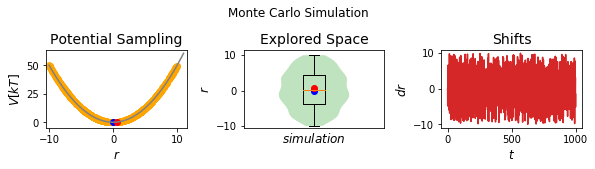

In [4]:
#Build System
sampler = monteCarloIntegrator(step_size_coefficient=5, space_range=[-10,10])
sys=system(potential=pot, sampler=sampler,  start_position=0)

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))

sys.trajectory.head()

#visualize Simulation in Plot:
simulation_analysis_plot(sys, title="Monte Carlo Simulation", limits_coordinate_space=list(range(-10,11)))

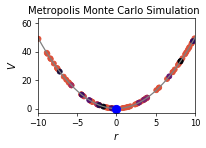

In [5]:
#Show Animation
animation, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Metropolis Monte Carlo Simulation", every_n_frame=10)
animation

### Metropolis Monte Carlo

Simulation:  Simulation: 100%|██████████| 1000/1000 [00:06<00:00, 150.16it/s]



last_state:  State(position=array(-1.83793269), temperature=298.0, total_system_energy=1.6889982812816369, total_potential_energy=1.6889982812816369, total_kinetic_energy=nan, dhdpos=array(-3.75417424), velocity=nan)
1001


(<Figure size 602.656x150.664 with 3 Axes>, None)

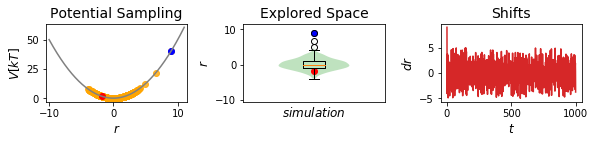

In [6]:
#super easy Metropolis_MonteCarlo simulation
sampler = metropolisMonteCarloIntegrator()
sys=system(potential=pot, sampler=sampler,  start_position=9)

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()

#plot
simulation_analysis_plot(sys, limits_coordinate_space=space_range)

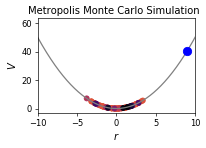

In [7]:
#plot
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Metropolis Monte Carlo Simulation", every_n_frame=10)
ani


## Optimizer - First order Methods

### Conjugated Gradient

Simulation:  Simulation: 100%|██████████| 1000/1000 [00:02<00:00, 361.59it/s]



last_state:  State(position=0.0, temperature=298.0, total_system_energy=0.0, total_potential_energy=0.0, total_kinetic_energy=nan, dhdpos=0.0, velocity=nan)
1001


(<Figure size 602.656x150.664 with 3 Axes>, None)

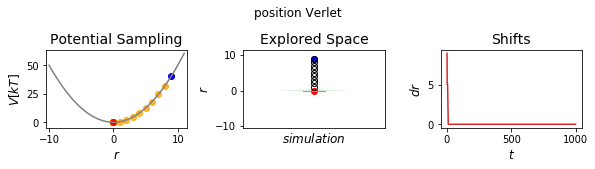

In [8]:
#settings
sampler = conjugate_gradient()
sys=system(potential=pot, sampler=sampler,  start_position=9)

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()

#plot
simulation_analysis_plot(sys, title="position Verlet", limits_coordinate_space=space_range)

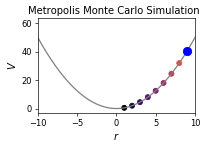

In [9]:
#animation
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Metropolis Monte Carlo Simulation")
ani

## Newtonian Integrators - Second order Methods

### Position Verlet

Simulation:  Simulation: 100%|██████████| 1000/1000 [00:02<00:00, 354.81it/s]


(<Figure size 602.656x150.664 with 3 Axes>, None)

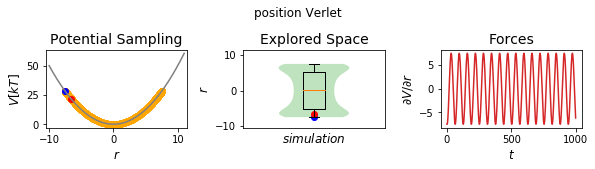

In [10]:
#Simulation Setup
sampler = positionVerletIntegrator(dt=0.1)
sys=system(potential=pot, sampler=sampler, start_position=-7.5)

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True, init_system=False)

sys.trajectory.head()

#plot
simulation_analysis_plot(sys, title="position Verlet", limits_coordinate_space=space_range)

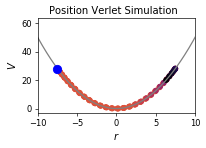

In [11]:
#animation
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Position Verlet Simulation")
ani

### Langevin Integrator

Simulation:  Simulation: 100%|██████████| 1000/1000 [00:05<00:00, 173.77it/s]


Trajectory length:  1001

last_state:  State(position=array(-1.42809239), temperature=15, total_system_energy=1.019723931805687, total_potential_energy=1.019723931805687, total_kinetic_energy=nan, dhdpos=1.2950899707279107, velocity=None)
1001


(<Figure size 602.656x150.664 with 3 Axes>, None)

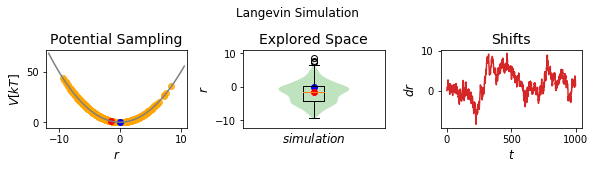

In [12]:
#Simple Langevin integration simulation:
#Thermostat is already included (Langevin thermostat)

#imports

time_step = 0.2
start_position = 0
temperature = 15
space_range = [-10,10]

#Simulation Setup
pbc = periodicBoundaryCondition(boundary=[space_range])
sampler = langevinIntegrator(dt=time_step, gamma=15, old_position=0.01)
sys=system(potential=pot, sampler=sampler,  start_position=0,  temperature=temperature, conditions=[pbc])

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True, init_system=False)

print("Trajectory length: ",len(sys.trajectory))
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()

##visualize
simulation_analysis_plot(sys, title="Langevin Simulation")


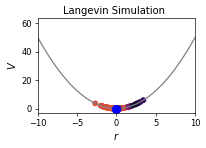

In [13]:
#animation
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Langevin Simulation")
ani


## TwoD potentials

In [14]:
# Imports:
import os, sys
my_path = os.getcwd()+"/.."
print(my_path)
sys.path.append(my_path)

import numpy as np
import matplotlib
from matplotlib import pyplot as plt
%matplotlib inline


#Ensembler
##COde
from ensembler.potentials.TwoD import wavePotential
from ensembler.samplers.stochastic import monteCarloIntegrator, metropolisMonteCarloIntegrator, langevinIntegrator
from ensembler.samplers.newtonian import positionVerletIntegrator, leapFrogIntegrator
from ensembler.conditions.box_conditions import periodicBoundaryCondition

from ensembler.system import system

##Visualisation
from ensembler.visualisation import plotPotentials
from ensembler.visualisation.plotSimulations import simulation_analysis_plot


C:\Users\benja\OneDrive - ETH Zürich\PhD\Code\ensembler_public\examples/..


### Metropolis MonteCarlo

Simulation:  Simulation: 100%|██████████| 1000/1000 [00:18<00:00, 53.38it/s]


(<Figure size 1152x288 with 5 Axes>, None)

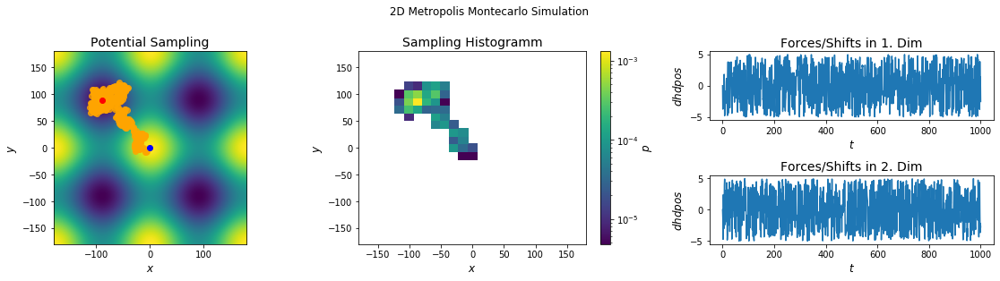

In [15]:
#settings
sim_steps=1000
space_range=[[-180, 180], [-180, 180]]

pbc = periodicBoundaryCondition(boundary=space_range)
pot2D=wavePotential(multiplicity=[2,2])
sampler = metropolisMonteCarloIntegrator(step_size_coefficient=5) # the maximal step for one MCM step can be  -+5 degree
sys=system(potential=pot2D, sampler=sampler,  conditions=[pbc], start_position=[0,0])

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
simulation_analysis_plot(system=sys, title=" 2D Metropolis Montecarlo Simulation", limits_coordinate_space=space_range)

### Lagevin

Simulation:  Simulation: 100%|██████████| 1000/1000 [00:07<00:00, 140.35it/s]


(<Figure size 1152x288 with 5 Axes>, None)

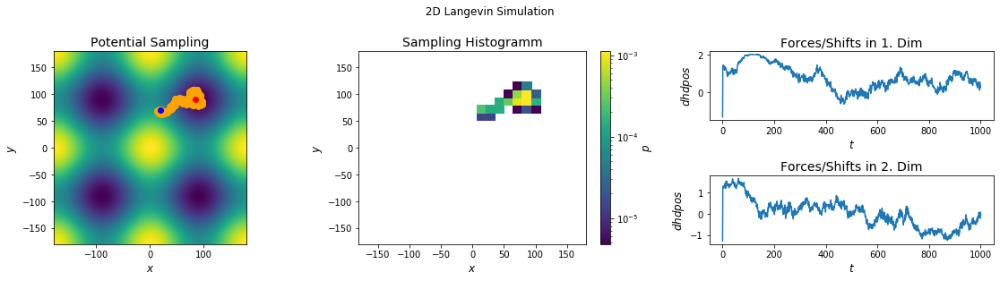

In [16]:
#settings
sim_steps=1000
space_range=[[-180, 180], [-180, 180]]

pbc = periodicBoundaryCondition(boundary=space_range)
pot2D=wavePotential(multiplicity=[2,2])
sampler = langevinIntegrator(dt=1, gamma=10 , old_position=[20.01,70.01])
sys=system(potential=pot2D, sampler=sampler,  start_position=[20,70], temperature=5, conditions=[pbc])

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True)

#Plot
simulation_analysis_plot(system=sys, title=" 2D Langevin Simulation", limits_coordinate_space=space_range)

### Newtonian Simulation

Simulation:  Simulation: 100%|██████████| 1000/1000 [00:06<00:00, 143.14it/s]


(<Figure size 1152x288 with 5 Axes>, None)

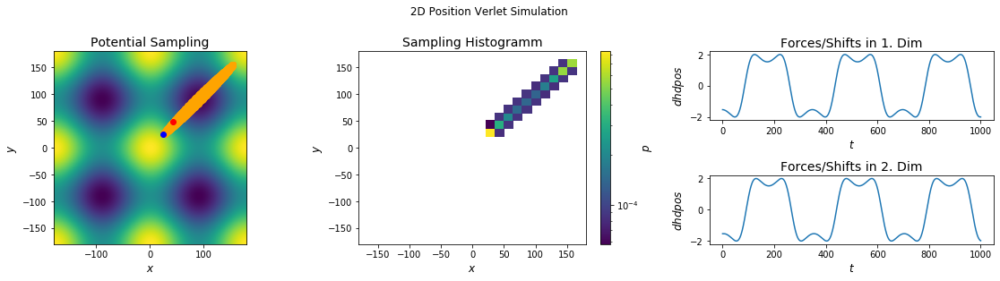

In [17]:

#settings
space_range=[[-180, 180], [-180, 180]]
sim_steps=1000

pbc = periodicBoundaryCondition(boundary=space_range)
pot2D=wavePotential(multiplicity=[2,2])
sampler = positionVerletIntegrator(dt=0.1)

sys=system(potential=pot2D, sampler=sampler,  start_position=[25,25], conditions=[pbc])

#simulate
cur_state = sys.simulate(sim_steps, withdraw_traj=True) 

simulation_analysis_plot(system=sys, title=" 2D Position Verlet Simulation", limits_coordinate_space=space_range)
